In [1]:
!pip install cufflinks
#!pip install geopandas==0.3.0
#!pip install pyshp==1.2.10
#!pip install shapely==1.6.3

     |████████████████████████████████| 81 kB 15.3 MB/s eta 0:00:01
  Created wheel for cufflinks: filename=cufflinks-0.17.3-py3-none-any.whl size=67921 sha256=2f47a716ff3a9bb39635c32602611c600fe952c5893914324ea07d2196345cc3
  Stored in directory: /home/jovyan/.cache/pip/wheels/e1/27/13/3fe67fa7ea7be444b831d117220b3b586b872c9acd4df480d0
Successfully built cufflinks


In [2]:
import plotly
import cufflinks as cf
cf.go_offline()

random_seed = 206

#import projectFunctions as pF
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import re

from razor import project_space_path as psp

In [3]:
import plotly
import cufflinks as cf
cf.go_offline()

In [4]:
prods = pd.read_csv('DataGeneration/data/product_details.csv')
purhist = pd.read_csv('DataGeneration/data/updated_purchase_history_table.csv')
cust = pd.read_csv('DataGeneration/data/updated_new_customer_table.csv')

In [5]:
prods.rename(lambda x: re.sub(' ','_',x.lower()), axis=1, inplace=True)
purhist.rename(lambda x: re.sub(' ','_',x.lower()), axis=1, inplace=True)
cust.rename(lambda x: re.sub(' ','_',x.lower()), axis=1, inplace=True)

In [6]:
cust['customer_dob'] = pd.to_datetime(cust.customer_dob, format='%Y-%m-%d')

trans = pd.merge(purhist, cust, on=['customer_id'])
#trans.drop(['transaction_id'],axis=1,inplace=True)

d_prodid2name = prods[['product_id','product_names']].set_index('product_id').to_dict()['product_names']
d_prodid2cat = prods[['product_id','product_category']].set_index('product_id').to_dict()['product_category']

trans['product_names'] = trans.product_id.map(d_prodid2name)
trans['product_category'] = trans.product_id.map(d_prodid2cat)

trans = trans.loc[:,['customer_id','product_id','purchase_date','product_names','product_category','customer_name','customer_dob','customer_age','customer_gender','customer_city','customer_state','customer_education','customer_marital_status','customer_professiontype','customer_salary_range','transaction_id']]

In [7]:
len(trans)

2586137

In [7]:
trans['purchase_date'] = pd.to_datetime(trans.purchase_date, format = '%Y-%m')
trans['customer_dob'] = pd.to_datetime(trans.customer_dob, format = '%Y-%m-%d')

In [65]:
#here age is wrt the last transaction date i.e 2017-03-01
#trans['customer_age'] = (pd.datetime(2017, 3, 1, 0, 0, 0) - trans.customer_dob) / (np.timedelta64(1, 'Y'))
#trans['customer_age'] = trans.customer_age.astype(int)

#making changes to customer dob
#trans.loc[(trans.customer_age < 18),'customer_dob'] = (trans[trans.customer_age < 18].customer_dob - np.timedelta64(18, 'Y'))#.apply(lambda x: x.date())

#again calculating the age
#trans['customer_age'] = (pd.datetime(2017, 3, 1, 0, 0, 0) - trans.customer_dob) / (np.timedelta64(1, 'Y'))
#trans['customer_age'] = trans.customer_age.astype(int)

In [66]:
#d_custid2dob = trans[['customer_id','customer_dob']].set_index('customer_id').to_dict()['customer_dob']
#cust['customer_dob'] = cust.customer_id.map(d_custid2dob)

In [67]:
#cust.to_csv('DataGeneration/data/updated_new_customer_table.csv', index=False)

In [68]:
#l_trad2roth = list(trans.loc[(trans.product_id == 4984622) & (trans.customer_age < 30),'transaction_id'])

#purhist.set_index('transaction_id', inplace=True)

#purhist.loc[l_trad2roth,'product_id'] = 4830668

#purhist.reset_index(inplace=True)

#purhist.to_csv('DataGeneration/data/updated_purchase_history_table.csv', index=False)

In [69]:
#trans.loc[trans.customer_age <21, 'customer_education'] = 'Diploma'

#d_custid2edu = trans[['customer_id','customer_education']].set_index('customer_id').to_dict()['customer_education']

#cust['customer_education'] = cust.customer_id.map(d_custid2edu)

#d_custid2age = trans[['customer_id','customer_age']].set_index('customer_id').to_dict()['customer_age']

#cust['customer_age'] = cust.customer_id.map(d_custid2age)

#cust.to_csv('DataGeneration/data/updated_new_customer_table.csv', index=False)

In [10]:
trans.head()

,customer_id,product_id,purchase_date,product_names,product_category,customer_name,customer_dob,customer_age,customer_gender,customer_city,customer_state,customer_education,customer_marital_status,customer_professiontype,customer_salary_range,transaction_id
0,A0000001,4697906,2007-05-01,Everyday Checking Accounts,Checking Accounts,Patrick Butler,1946-08-06,70,male,Monticello,Iowa,Diploma,No,Private,In Between 50K and 75K,cd0fed92-8e44-46aa-8b73-b2088661530f
1,A0000001,4746218,2013-04-01,ExpressSend® Service,Forex,Patrick Butler,1946-08-06,70,male,Monticello,Iowa,Diploma,No,Private,In Between 50K and 75K,0beb8362-7630-4c94-b42e-c536c8d922e1
2,A0000001,4805670,2011-04-01,Portfolio Checking Accounts,Checking Accounts,Patrick Butler,1946-08-06,70,male,Monticello,Iowa,Diploma,No,Private,In Between 50K and 75K,a8eaf40f-9fdb-423c-ad64-9d38d9f8929f
3,A0000002,4536150,2015-02-01,Tax Saver Fixed Deposit,Fixed Deposit,Ernest Brown,1945-07-29,71,male,Shelburn,Indiana,Graduated,Yes,Private,less than 25K,1861f61a-2571-40ef-b5dd-61ee8610b5a2
4,A0000003,4497036,2012-05-01,Clear Access Banking Checking Accounts,Checking Accounts,Rose Hobbs,1950-01-25,67,female,Lenhartsville,Pennsylvania,Graduated,Yes,Private,Greater than 100K,b7241aa6-dee3-44a3-b291-c651ddc5e2a4


### EDA

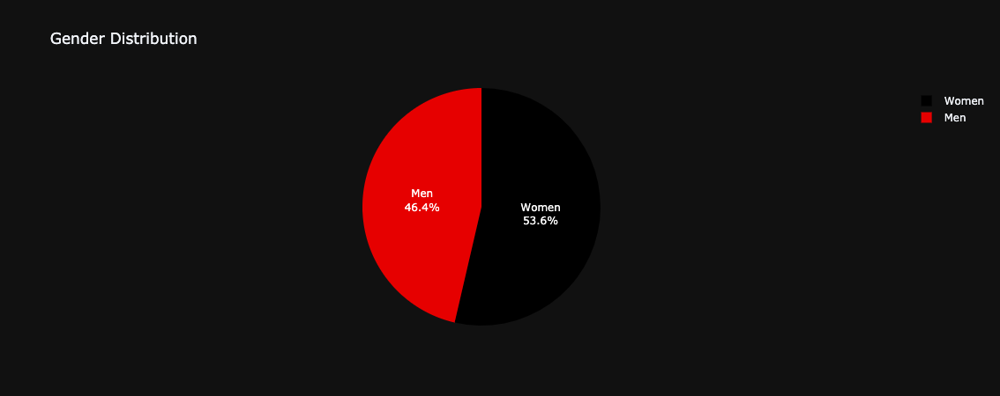

In [71]:
temp= pd.DataFrame(cust.customer_gender.value_counts(sort=False))
temp.rename(columns = {'customer_gender':'#records'}, inplace=True)
temp['Gender'] = ['Women','Men']

import plotly.express as px
fig = px.pie(temp, 
            values = '#records', 
            names = 'Gender', 
            title= 'Gender Distribution',
            template='plotly_dark',
            color_discrete_sequence=px.colors.sequential.Hot)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

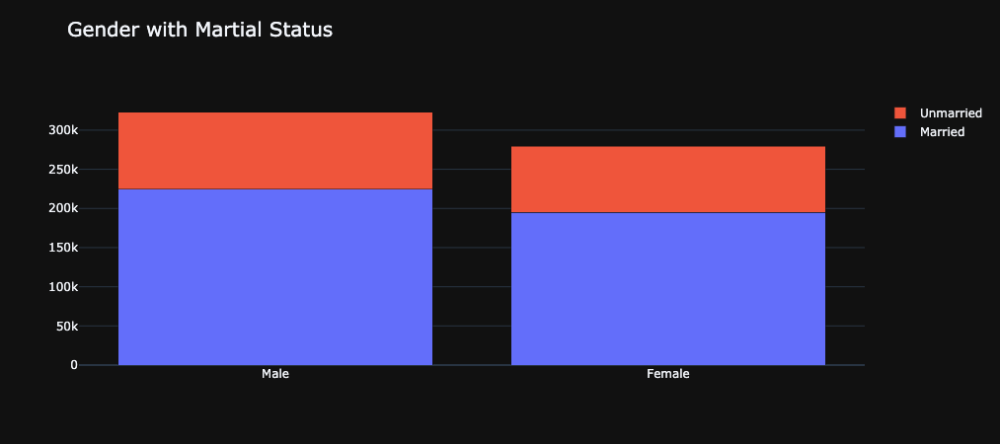

In [72]:
temp = cust.groupby(['customer_marital_status','customer_gender']).size().reset_index()


import plotly.graph_objects as go
gender=['Male', 'Female']

fig = go.Figure(data=[
    go.Bar(name='Married', x=gender, y=[224672,194794]),
    go.Bar(name='Unmarried', x=gender, y=[98494,84713])
])
# Change the bar mode
fig.update_layout(barmode = 'stack',font_size = 12, title_font_size = 20, title={
        'text': "Gender with Martial Status",
        'y':0.95,
        'x':0.2,
        'xanchor': 'center',
        'yanchor': 'top'},
        template = 'plotly_dark')
fig.show()

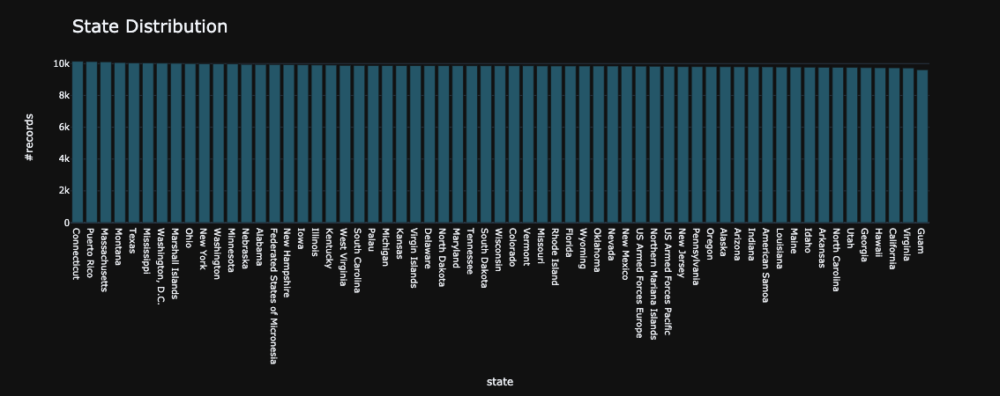

In [73]:
temp = cust.customer_state.value_counts().reset_index().rename(columns={'index':'state','customer_state':'#records'})

fig = px.bar(temp, x='state', y='#records', template='plotly_dark', color_discrete_sequence=px.colors.sequential.Aggrnyl)

fig.update_layout(font_size = 10, title_font_size = 20, title={
        'text': "State Distribution",
        'y':0.95,
        'x':0.15,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

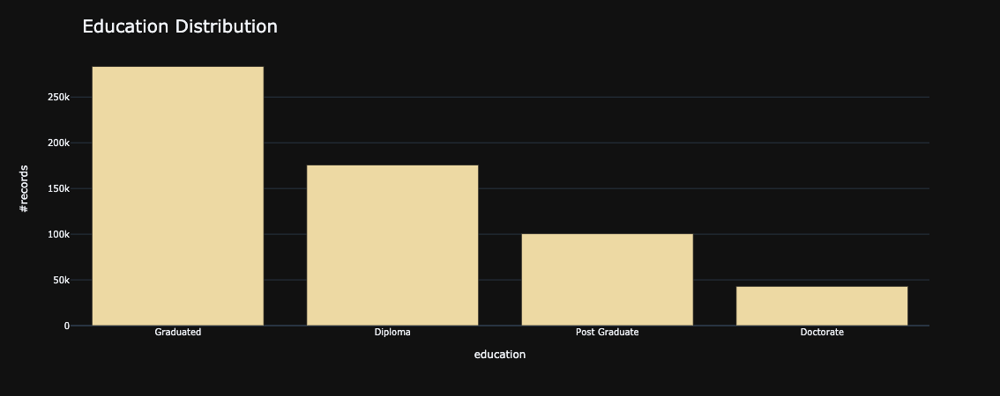

In [74]:
temp = cust.customer_education.value_counts().reset_index().rename(columns={'index':'education','customer_education':'#records'})

fig = px.bar(temp, x='education', y='#records', template='plotly_dark', color_discrete_sequence=px.colors.sequential.Agsunset_r)

fig.update_layout(font_size = 10, title_font_size = 20, title={
        'text': "Education Distribution",
        'y':0.95,
        'x':0.18,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

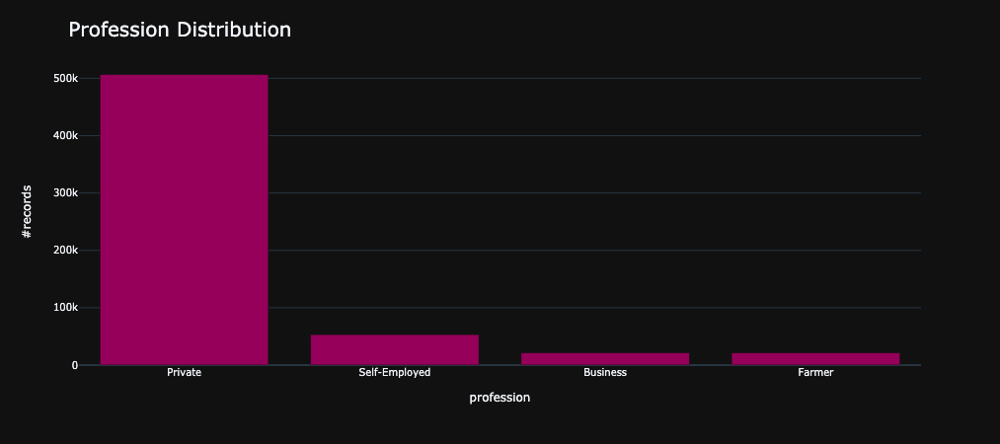

In [75]:
temp = cust.customer_professiontype.value_counts().reset_index().rename(columns={'index':'profession','customer_professiontype':'#records'})

fig = px.bar(temp, x='profession', y='#records', template='plotly_dark', color_discrete_sequence=px.colors.sequential.Rainbow)

fig.update_layout(font_size = 10, title_font_size = 20, title={
        'text': "Profession Distribution",
        'y':0.95,
        'x':0.18,
        'xanchor': 'center',
        'yanchor': 'top'})
fig.show()

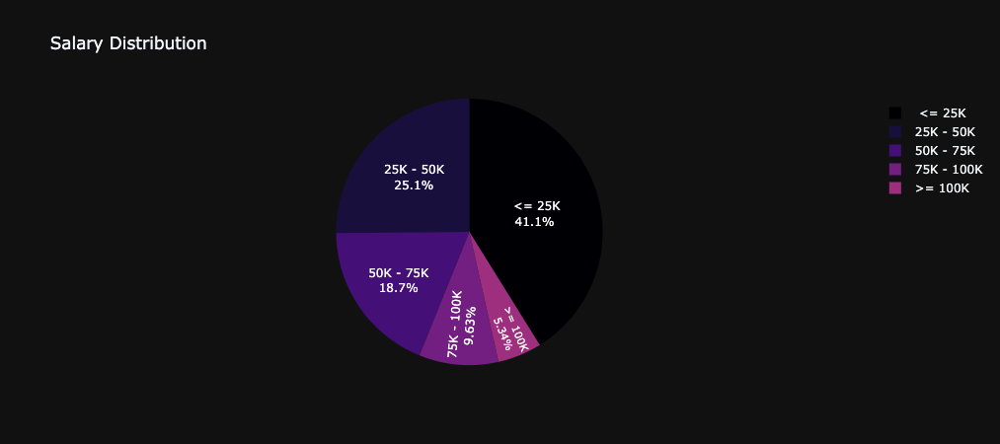

In [76]:
temp = pd.DataFrame(cust.customer_salary_range.value_counts())
temp['sort'] = [1,2,0,4,3]
temp.rename(columns = {'customer_salary_range':'#people'}, inplace=True)
temp['Salary'] = [' <= 25K', '25K - 50K', '50K - 75K', '75K - 100K', '>= 100K']

import plotly.express as px
fig = px.pie(temp, 
            values = '#people', 
            names = 'Salary', 
            title= 'Salary Distribution',
            template='plotly_dark',
            color_discrete_sequence=px.colors.sequential.Magma)
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

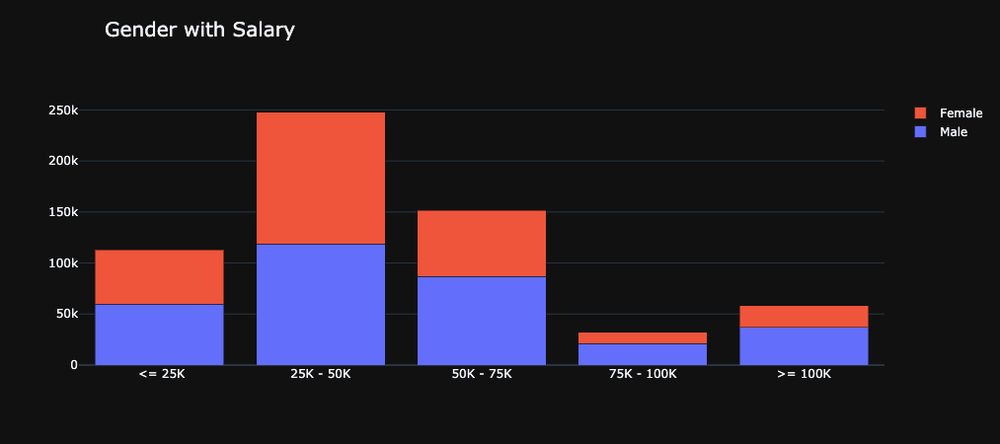

In [77]:
temp = cust.groupby(['customer_gender','customer_salary_range']).size().reset_index()

import plotly.graph_objects as go
salary=[' <= 25K', '25K - 50K', '50K - 75K', '75K - 100K', '>= 100K']

fig = go.Figure(data=[
    go.Bar(name='Male', x = salary, y=[59496,118865,86833,20866,37106]),
    go.Bar(name='Female', x = salary, y=[53494,129113,64661,11324,20915])
])
# Change the bar mode
fig.update_layout(barmode = 'stack',font_size = 12, title_font_size = 20, title={
        'text': "Gender with Salary",
        'y':0.95,
        'x':0.2,
        'xanchor': 'center',
        'yanchor': 'top'},
        template = 'plotly_dark')
fig.show()

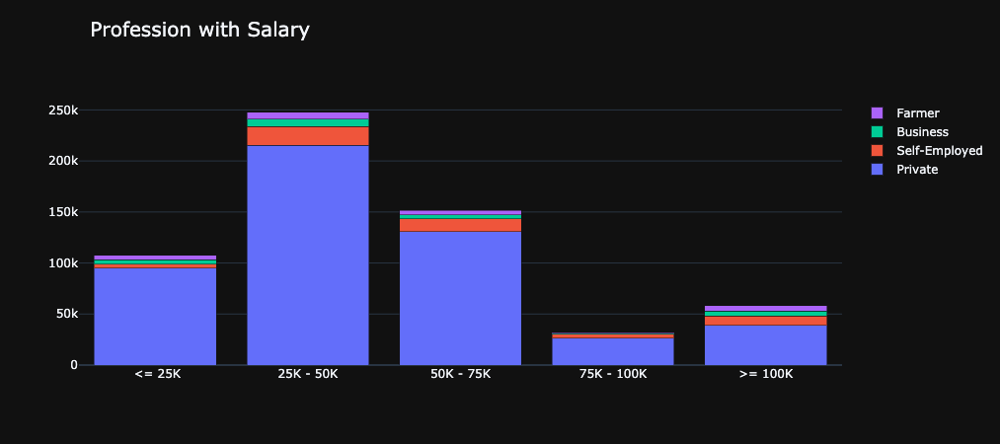

In [117]:
temp = cust.groupby(['customer_gender','customer_salary_range']).size().reset_index()

import plotly.graph_objects as go
salary=[' <= 25K', '25K - 50K', '50K - 75K', '75K - 100K', '>= 100K']

fig = go.Figure(data=[
    go.Bar(name='Private', x = salary, y=[95159,215303,130798,26367,39016]),
    go.Bar(name='Self-Employed', x = salary, y=[3692,18612,12516,3692,9058]),
    go.Bar(name='Business', x = salary, y=[4291,7160,4095,1228,4685]),
    go.Bar(name='Farmer', x = salary, y=[4212,6903,4085,903,5262])
    
])
# Change the bar mode
fig.update_layout(barmode = 'stack',font_size = 12, title_font_size = 20, title={
        'text': "Profession with Salary",
        'y':0.95,
        'x':0.2,
        'xanchor': 'center',
        'yanchor': 'top'},
        template = 'plotly_dark')
fig.show()

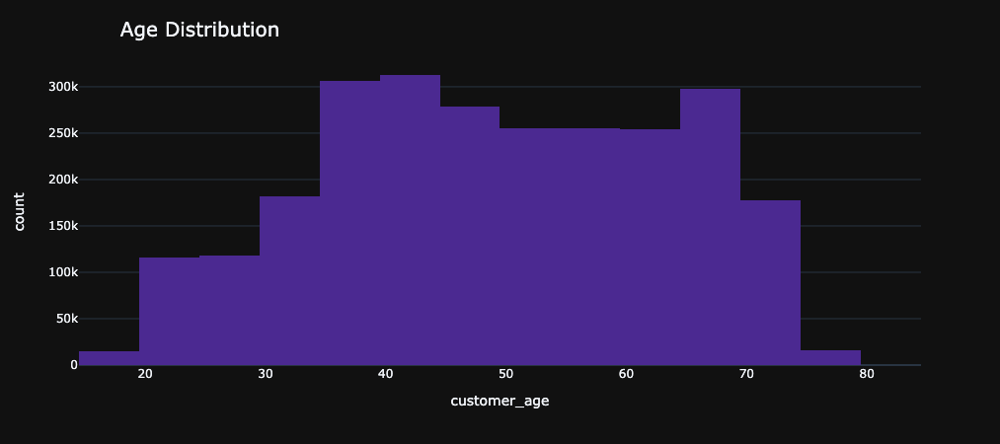

In [80]:
fig = px.histogram(trans, x="customer_age", nbins=20, color_discrete_sequence=px.colors.sequential.Agsunset)
fig.update_layout(font_size = 12, title_font_size = 20, title={
        'text': "Age Distribution",
        'y':0.95,
        'x':0.2,
        'xanchor': 'center',
        'yanchor': 'top'},
        template = 'plotly_dark')
fig.show()

In [84]:
caja = pd.read_csv(razor.project_space_path('/bank-product-recommendation/data/train.txt'), delimiter = '|')

In [88]:
caja['Cod_Fecha'] = pd.to_datetime(caja.Cod_Fecha, format='%Y-%m')

In [89]:
caja.Cod_Prod

,ID_Customer,Cod_Prod,Cod_Fecha,Socio_Demo_01,Socio_Demo_02,Socio_Demo_03,Socio_Demo_04,Socio_Demo_05
0,A0000001,601,2007-05-01,5,4,3,1,0
1,A0000001,704,2013-04-01,5,4,3,1,0
2,A0000001,2501,2006-03-01,5,4,3,1,0
3,A0000001,2503,2006-03-01,5,4,3,1,0
4,A0000001,1011,2011-04-01,5,4,3,1,0
...,...,...,...,...,...,...,...,...
3350596,A0676369,2302,2015-10-01,3,2,3,1,0
3350597,A0676369,601,2015-07-01,3,2,3,1,0
3350598,A0676369,2205,2015-07-01,3,2,3,1,0
3350599,A0676370,601,2015-11-01,3,2,2,1,0


In [98]:
caja['prod_names'] = caja.Cod_Prod.map(prods[['cod_prod','product_names']].set_index('cod_prod').to_dict()['product_names'])

In [102]:
caja[caja.ID_Customer == 'A0000001'].sort_values('Cod_Fecha')

,ID_Customer,Cod_Prod,Cod_Fecha,Socio_Demo_01,Socio_Demo_02,Socio_Demo_03,Socio_Demo_04,Socio_Demo_05,prod_names
2,A0000001,2501,2006-03-01,5,4,3,1,0,ATM Card
3,A0000001,2503,2006-03-01,5,4,3,1,0,Roth IRA
0,A0000001,601,2007-05-01,5,4,3,1,0,Everyday Checking Accounts
4,A0000001,1011,2011-04-01,5,4,3,1,0,Portfolio Checking Accounts
1,A0000001,704,2013-04-01,5,4,3,1,0,ExpressSend® Service


In [14]:
trans.head()

,customer_id,product_id,purchase_date,product_names,product_category,customer_name,customer_dob,customer_age,customer_gender,customer_city,customer_state,customer_education,customer_marital_status,customer_professiontype,customer_salary_range,transaction_id
0,A0000001,4697906,2007-05-01,Everyday Checking Accounts,Checking Accounts,Patrick Butler,1946-08-06,70,male,Monticello,Iowa,Diploma,No,Private,In Between 50K and 75K,cd0fed92-8e44-46aa-8b73-b2088661530f
1,A0000001,4746218,2013-04-01,ExpressSend® Service,Forex,Patrick Butler,1946-08-06,70,male,Monticello,Iowa,Diploma,No,Private,In Between 50K and 75K,0beb8362-7630-4c94-b42e-c536c8d922e1
2,A0000001,4805670,2011-04-01,Portfolio Checking Accounts,Checking Accounts,Patrick Butler,1946-08-06,70,male,Monticello,Iowa,Diploma,No,Private,In Between 50K and 75K,a8eaf40f-9fdb-423c-ad64-9d38d9f8929f
3,A0000002,4536150,2015-02-01,Tax Saver Fixed Deposit,Fixed Deposit,Ernest Brown,1945-07-29,71,male,Shelburn,Indiana,Graduated,Yes,Private,less than 25K,1861f61a-2571-40ef-b5dd-61ee8610b5a2
4,A0000003,4497036,2012-05-01,Clear Access Banking Checking Accounts,Checking Accounts,Rose Hobbs,1950-01-25,67,female,Lenhartsville,Pennsylvania,Graduated,Yes,Private,Greater than 100K,b7241aa6-dee3-44a3-b291-c651ddc5e2a4


80